# Time Series Graphs - Traffic

In [14]:
import sys
sys.path.insert(0, '.')
from utils import *
import pandas as pd

## 1. DataFrames

In [15]:
traffic = pd.read_csv('all_six_datasets/traffic/traffic.csv', parse_dates=['date'])
traffic.set_index('date', inplace=True)
traffic

,0,1,2,3,4,5,6,7,8,9,...,852,853,854,855,856,857,858,859,860,OT
date,,,,,,,,,,,,,,,,,,,,,
2016-07-01 02:00:00,0.0048,0.0146,0.0289,0.0142,0.0064,0.0232,0.0162,0.0242,0.0341,0.0375,...,0.0051,0.0051,0.0074,0.0079,0.0051,0.0051,0.0339,0.0051,0.0100,0.0121
2016-07-01 03:00:00,0.0072,0.0148,0.0350,0.0174,0.0084,0.0240,0.0201,0.0338,0.0434,0.0381,...,0.0036,0.0036,0.0107,0.0058,0.0036,0.0036,0.0348,0.0036,0.0087,0.0136
2016-07-01 04:00:00,0.0040,0.0101,0.0267,0.0124,0.0049,0.0170,0.0127,0.0255,0.0332,0.0309,...,0.0030,0.0030,0.0043,0.0050,0.0030,0.0030,0.0327,0.0030,0.0061,0.0107
2016-07-01 05:00:00,0.0039,0.0060,0.0218,0.0090,0.0029,0.0118,0.0088,0.0163,0.0211,0.0199,...,0.0033,0.0033,0.0019,0.0052,0.0033,0.0033,0.0292,0.0033,0.0040,0.0071
2016-07-01 06:00:00,0.0042,0.0055,0.0191,0.0082,0.0024,0.0095,0.0064,0.0087,0.0144,0.0226,...,0.0049,0.0049,0.0011,0.0071,0.0049,0.0049,0.0264,0.0049,0.0040,0.0039
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-07-01 21:00:00,0.0342,0.0332,0.1378,0.0559,0.0165,0.0386,0.0457,0.0687,0.0716,0.0518,...,0.0139,0.0179,0.0278,0.0280,0.0227,0.0375,0.0142,0.0201,0.0341,0.0429
2018-07-01 22:00:00,0.0285,0.0253,0.0542,0.0485,0.0131,0.0331,0.0372,0.0569,0.0669,0.0409,...,0.0116,0.0155,0.0201,0.0267,0.0207,0.0320,0.0122,0.0163,0.0306,0.0363
2018-07-01 23:00:00,0.0276,0.0257,0.0551,0.0474,0.0121,0.0326,0.0381,0.0566,0.0675,0.0386,...,0.0109,0.0142,0.0208,0.0252,0.0189,0.0287,0.0123,0.0152,0.0292,0.0325


## 4 Heatmaps of Correlation Matrices

### 4.1 Heatmap of Correlation Matrix for Entire Dataset

            0         1         2         3         4         5         6  \
0    1.000000  0.750833  0.528709  0.598725  0.804868  0.133726  0.275026   
1    0.750833  1.000000  0.520625  0.573012  0.858089  0.044924  0.198494   
2    0.528709  0.520625  1.000000  0.593493  0.474587  0.375431  0.523268   
3    0.598725  0.573012  0.593493  1.000000  0.567370  0.495178  0.565182   
4    0.804868  0.858089  0.474587  0.567370  1.000000  0.023734  0.180994   
..        ...       ...       ...       ...       ...       ...       ...   
857  0.416623  0.368116  0.696195  0.675591  0.318062  0.699391  0.780298   
858  0.417221  0.418497  0.646572  0.601067  0.364157  0.454755  0.554497   
859  0.337733  0.309183  0.603397  0.581161  0.253505  0.556539  0.618035   
860  0.463414  0.465276  0.706176  0.622377  0.419941  0.464344  0.580245   
OT   0.390900  0.340950  0.726195  0.680107  0.277518  0.682346  0.761566   

            7         8         9  ...       852       853       854  \
0  

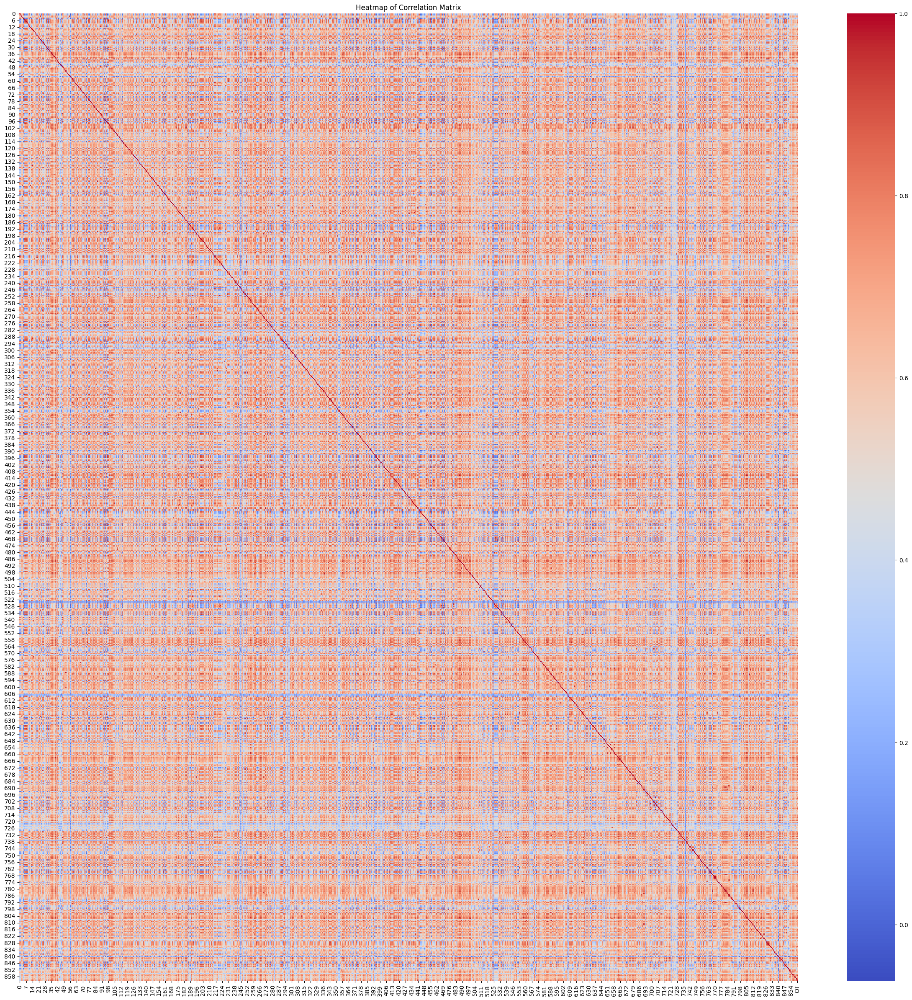

In [18]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Replace with your CSV file path
file_path = 'all_six_datasets/traffic/traffic.csv'

# Read the data, assuming each column is a feature and each row is a time step
df = pd.read_csv(file_path)

# If there's a datetime column in the DataFrame, remove it (assuming the column name is 'date')
if 'date' in df.columns:
    df = df.drop('date', axis=1)

# Ensure the DataFrame contains only numeric data
df = df.select_dtypes(include=[np.number])

# Calculate the correlation matrix
correlation_matrix = df.corr()

# Print the correlation matrix
print(correlation_matrix)

# Visualize the correlation matrix as a heatmap
plt.figure(figsize=(30, 30))  # Adjust the size of the heatmap as needed
sns.heatmap(correlation_matrix, cmap='coolwarm', fmt=".2f")
plt.title('Heatmap of Correlation Matrix')
plt.show()


### 4.2 Heatmap of Correlation Matrix for sgemented Dataset

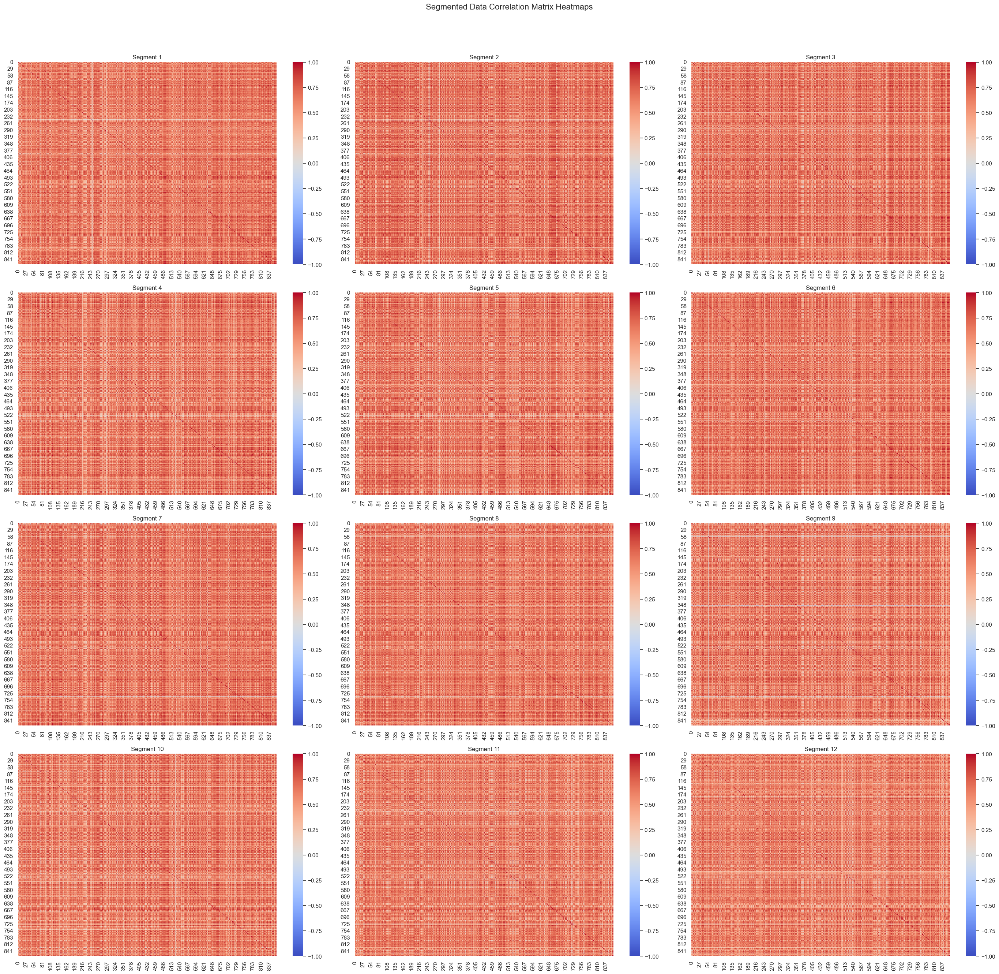

In [19]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Load the dataset
file_path = 'all_six_datasets/traffic/traffic.csv'
df = pd.read_csv(file_path)

# Select numeric columns
df_numeric = df.select_dtypes(include=[np.number])

# Total number of segments
total_segments = 12

# Calculate the number of rows each time segment should contain, using integer division to ensure an integer result
segment_size = df.shape[0] // total_segments

# Set the plotting style
sns.set(style="white")

# Prepare to plot multiple subplots, 4 rows by 3 columns
fig, axes = plt.subplots(4, 3, figsize=(28, 28))  # Overall size of the figure
fig.suptitle('Segmented Data Correlation Matrix Heatmaps', fontsize=16)

# Iterate through each time segment and plot the correlation matrix heatmap on a subplot
for segment in range(total_segments):
    # Calculate the starting and ending row for the current segment
    start_row = segment * segment_size
    # For the last segment, ensure it contains all remaining rows
    end_row = start_row + segment_size if segment < total_segments - 1 else df.shape[0]
    segment_df = df_numeric.iloc[start_row:end_row]
    
    # Calculate the correlation matrix for the current segment
    correlation_matrix = segment_df.corr()
    
    # Find the corresponding subplot location
    ax = axes[segment // 3, segment % 3]
    
    # Plot the heatmap on the subplot
    sns.heatmap(correlation_matrix, fmt=".2f", cmap='coolwarm', vmin=-1, vmax=1, ax=ax)
    ax.set_title(f'Segment {segment + 1}')

# Adjust spacing between subplots
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()


### Generating GIF

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import os

# Load the dataset
file_path = 'all_six_datasets/traffic/traffic.csv'
df = pd.read_csv(file_path)

# Total number of segments now set to 100
total_segments = 100

# Calculate the number of rows each time segment should contain, using integer division
segment_size = df.shape[0] // total_segments

# Directory to save plots
plots_dir = 'temp_plots'
os.makedirs(plots_dir, exist_ok=True)

# Generate and save plots
for segment in range(total_segments):
    start_row = segment * segment_size
    end_row = start_row + segment_size if segment < total_segments - 1 else df.shape[0]
    segment_df = df.iloc[start_row:end_row].select_dtypes(include=[np.number])
    correlation_matrix = segment_df.corr()
    
    plt.figure(figsize=(10, 8))
    sns.heatmap(correlation_matrix, fmt=".2f", cmap='coolwarm', vmin=-1, vmax=1)
    plt.title(f'Segment {segment + 1}')
    
    # Save plot as image
    plt.savefig(f'{plots_dir}/segment_{segment + 1}.png')
    plt.close()


In [2]:
from PIL import Image
import numpy as np
import os

def interpolate_frames(image1, image2, steps=1):
    """
    Generate interpolated frames between two images.
    :param image1: PIL Image object for the first image.
    :param image2: PIL Image object for the second image.
    :param steps: Number of interpolated frames to generate between the two images.
    :return: List of PIL Image objects, including the first image, interpolated images, but excluding the second image.
    """
    images = [image1]
    for step in range(1, steps + 1):
        alpha = step / (steps + 1)
        interpolated_image = Image.blend(image1, image2, alpha)
        images.append(interpolated_image)
    return images

# Path to the folder containing the images
image_folder = 'temp_plots'

# Number of interpolation steps between each original frame
interpolation_steps = 2  # Adjust this to add more or fewer interpolated frames

# Adjust based on actual number of images
image_files = [os.path.join(image_folder, f'segment_{i}.png') for i in range(1, 101)]

# Load all images using Pillow
images = [Image.open(image_file).convert("RGBA") for image_file in image_files]

# Insert interpolated frames between original frames to make the animation smoother
smoothed_images = []
for i in range(len(images) - 1):
    smoothed_images.extend(interpolate_frames(images[i], images[i+1], steps=interpolation_steps))
smoothed_images.append(images[-1])  # Add the last frame

# Durations for the GIFs
durations = [100, 300, 500]

# Generate GIFs with different durations
for duration in durations:
    gif_path = f'smooth_output_{duration}.gif'  # Modify GIF path to include duration
    smoothed_images[0].save(gif_path, save_all=True, append_images=smoothed_images[1:], optimize=False, duration=duration, loop=0)
    print(f'GIF with duration {duration}ms has been saved to {gif_path}')


GIF with duration 100ms has been saved to smooth_output_100.gif
GIF with duration 300ms has been saved to smooth_output_300.gif
GIF with duration 500ms has been saved to smooth_output_500.gif
